In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium.plugins import BeautifyIcon

In [2]:
zipcodes = gpd.read_file('../data/zipcodes.geojson')

In [3]:
print(zipcodes.crs)
zipcodes.head()

epsg:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,11,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


In [4]:
type(zipcodes)

geopandas.geodataframe.GeoDataFrame

In [5]:
zipcodes.shape

(56, 6)

In [6]:
nash_zipcodes = zipcodes.loc[zipcodes['po_name'] == 'NASHVILLE']

In [7]:
nash_zipcodes = nash_zipcodes.reset_index(drop=True)

In [8]:
nash_zipcodes

,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
1,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
2,37221,17,NASHVILLE,241372.3112694624,1266395059.4877319,"MULTIPOLYGON (((-86.97084 36.11644, -86.97084 ..."
3,37212,54,NASHVILLE,58759.243654332378,73920091.147705078,"MULTIPOLYGON (((-86.80790 36.14643, -86.80605 ..."
4,37209,10,NASHVILLE,310224.91345860378,1001364029.2892456,"MULTIPOLYGON (((-86.97543 36.20877, -86.97221 ..."
5,37206,2,NASHVILLE,75782.862116030214,221537063.58166504,"MULTIPOLYGON (((-86.75348 36.16274, -86.75383 ..."
6,37217,56,NASHVILLE,179866.56847992647,517579208.08972168,"MULTIPOLYGON (((-86.67355 36.12729, -86.66687 ..."
7,37207,49,NASHVILLE,14456.130686344946,6987521.0933837891,"MULTIPOLYGON (((-86.78596 36.29097, -86.78595 ..."
8,37219,15,NASHVILLE,21013.192337432083,6579013.4385986328,"MULTIPOLYGON (((-86.78609 36.17465, -86.78585 ..."
9,37218,55,NASHVILLE,253501.29953687743,1071962039.8548584,"MULTIPOLYGON (((-86.88231 36.26248, -86.88270 ..."


In [9]:
nash_zipcodes = nash_zipcodes[['zip','po_name','geometry']]

In [10]:
nash_zipcodes

,zip,po_name,geometry
0,37216,NASHVILLE,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
1,37204,NASHVILLE,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
2,37221,NASHVILLE,"MULTIPOLYGON (((-86.97084 36.11644, -86.97084 ..."
3,37212,NASHVILLE,"MULTIPOLYGON (((-86.80790 36.14643, -86.80605 ..."
4,37209,NASHVILLE,"MULTIPOLYGON (((-86.97543 36.20877, -86.97221 ..."
5,37206,NASHVILLE,"MULTIPOLYGON (((-86.75348 36.16274, -86.75383 ..."
6,37217,NASHVILLE,"MULTIPOLYGON (((-86.67355 36.12729, -86.66687 ..."
7,37207,NASHVILLE,"MULTIPOLYGON (((-86.78596 36.29097, -86.78595 ..."
8,37219,NASHVILLE,"MULTIPOLYGON (((-86.78609 36.17465, -86.78585 ..."
9,37218,NASHVILLE,"MULTIPOLYGON (((-86.88231 36.26248, -86.88270 ..."


In [11]:
sidewalks = gpd.read_file('../data/sidewalk_inventory_for_ada_selfAssessment.geojson')

In [12]:
sidewalks.shape

(188344, 25)

In [13]:
type(sidewalks)

geopandas.geodataframe.GeoDataFrame

In [14]:
print(sidewalks.crs)
sidewalks.head()

epsg:4326


,evnt_lat,obj_pot,side,measure,curbtype,evnt_lon,sw_mat_ty,drv_ld,cr_slp,event_subt,...,drv_ti_mat,from,obj_hgt,cr_slp_d,routeid,drv_cs,obj_type,onst,tost,geometry
0,36.08965518,None,S,892,None,-86.62350564,None,0,None,None,...,None,Bell Rd,None,None,8600,None,None,Smith Springs Rd,Rural Hill Rd,POINT (-86.62351 36.08966)
1,36.16262,None,W,390.4704334,None,-86.81184584,None,0,0,FLUSH,...,None,Morena St,None,None,93,0,BIKE FRIENDLY,24th Ave N,Herman St,POINT (-86.81185 36.16262)
2,36.16528346,None,N,161,None,-86.81559108,None,0,None,POINT,...,None,26th Ave N,None,None,26,None,HC-L,Albion St,25th Ave N,POINT (-86.81559 36.16528)
3,36.16549622,None,S,425,None,-86.81060602,None,-1,None,None,...,GRAVEL,24th Ave N,None,None,36,7.4,RESDRW-MID,Albion St,21st Ave N,POINT (-86.81061 36.16550)
4,36.16658087,"LESS THAN 32""",N,218,None,-86.81150264,None,0,None,None,...,None,24th Ave N,None,None,4,None,VEGPT,Alameda St,21st Ave N,POINT (-86.81150 36.16658)


In [15]:
sidewalks.columns

Index(['evnt_lat', 'obj_pot', 'side', 'measure', 'curbtype', 'evnt_lon',
       'sw_mat_ty', 'drv_ld', 'cr_slp', 'event_subt', 'drv_cs_d', 'repaired',
       'fur_zn_w', 'sw_width', 'evnt_type', 'drv_ti_mat', 'from', 'obj_hgt',
       'cr_slp_d', 'routeid', 'drv_cs', 'obj_type', 'onst', 'tost',
       'geometry'],
      dtype='object')

In [16]:
sidewalks = sidewalks.drop(columns = ['side','measure','curbtype','drv_ld', 'cr_slp','drv_cs_d','fur_zn_w','from', 'obj_hgt',
       'cr_slp_d','drv_cs'])

In [17]:
sidewalks

,evnt_lat,obj_pot,evnt_lon,sw_mat_ty,event_subt,repaired,sw_width,evnt_type,drv_ti_mat,routeid,obj_type,onst,tost,geometry
0,36.08965518,None,-86.62350564,None,None,NA,0,SW_CS,None,8600,None,Smith Springs Rd,Rural Hill Rd,POINT (-86.62351 36.08966)
1,36.16262,None,-86.81184584,None,FLUSH,NA,0,STORMGRATES,None,93,BIKE FRIENDLY,24th Ave N,Herman St,POINT (-86.81185 36.16262)
2,36.16528346,None,-86.81559108,None,POINT,1,0,CONC_DEFECTS,None,26,HC-L,Albion St,25th Ave N,POINT (-86.81559 36.16528)
3,36.16549622,None,-86.81060602,None,None,NA,0,DRIVEWAY,GRAVEL,36,RESDRW-MID,Albion St,21st Ave N,POINT (-86.81061 36.16550)
4,36.16658087,"LESS THAN 32""",-86.81150264,None,None,NA,0,POLE,None,4,VEGPT,Alameda St,21st Ave N,POINT (-86.81150 36.16658)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188339,36.23846733,"LESS THAN 32""",-86.79980543,None,None,NA,0,BOXES,None,11486,MAILBOXRES,Rock Creek Trace,Cul-De-Sac,POINT (-86.79981 36.23847)
188340,36.0674462,None,-86.63103782,CONCRETE,None,NA,5,SW_ATTRIBUTE,None,11566,BEG_SW_NWR,Forest View Dr,Forest Pointe Pl,POINT (-86.63104 36.06745)
188341,36.00997035,None,-86.68730975,AGGREGATE,None,NA,5,SW_ATTRIBUTE,None,11456,BEG_SW_NOR,Ochoa Ln,Stecoah St,POINT (-86.68731 36.00997)
188342,36.23235414,None,-86.74490148,None,POINT,NA,0,CONC_DEFECTS,None,11592,HC-L,Joyce Ln,Lemont Dr,POINT (-86.74490 36.23235)


In [18]:
sidewalks.repaired.value_counts()

NA    173801
1      14543
Name: repaired, dtype: int64

In [19]:
sidewalks.evnt_type.value_counts()

CONC_DEFECTS              84275
SW_ATTRIBUTE              44186
STORMGRATES               23078
DRIVEWAY                  17349
POLE                      11393
SW_CS                      6568
SIGN                        627
CASTINGS                    581
BOXES                       156
RETWALL                     106
STORMGRATES\TREECANOPY       23
Name: evnt_type, dtype: int64

In [20]:
sidewalks.obj_type.value_counts()

BIKE FRIENDLY        19091
FC-L                 16638
HC-L                 13100
SPALLING-L           11726
RESDRW-MID           10791
                     ...  
SD-PLANTER               1
SD-POLE LINE SIGN        1
SD-POLE                  1
POINT                    1
END-SW                   1
Name: obj_type, Length: 92, dtype: int64

In [21]:
sidewalks.obj_pot.value_counts()

LESS THAN 32"         8816
GREATER THAN 36"       930
32" - 36"              674
VERT                   555
YES > 1/4" SETTLED     271
YES > 1/4"             216
NONE-FLUSH              90
Name: obj_pot, dtype: int64

In [22]:
sidewalks.sw_width.value_counts()

0       156323
5        17741
6         2496
5.5       2147
4         1714
         ...  
7.3          1
5.8          1
33.5         1
5.4          1
7.1          1
Name: sw_width, Length: 105, dtype: int64

In [23]:
sidewalks.drv_ti_mat.value_counts()

ASPHALT      6825
GRAVEL       4871
WHITECONC    2516
EXPCONC      2007
AGGREGATE    1067
WITECONC        1
Name: drv_ti_mat, dtype: int64

In [24]:
nash_sidewalks = gpd.sjoin(sidewalks, nash_zipcodes, op = 'within')

In [25]:
nash_sidewalks.zip.value_counts()

37208    18177
37203    16853
37206    15045
37212    14601
37209    12174
37207    11248
37210    10696
37211     9566
37214     7410
37204     6675
37221     5299
37216     5102
37205     4243
37217     3126
37215     2862
37201     2065
37218     2030
37213     1980
37219     1117
37228      960
37220      500
37232      117
37240       81
Name: zip, dtype: int64

In [26]:
sidewalks_over_10k_observations = nash_sidewalks.loc[nash_sidewalks.zip == '37208']

In [27]:
sidewalks_over_10k_observations.shape

(18177, 17)

In [28]:
sidewalks_over_10k_observations

,evnt_lat,obj_pot,evnt_lon,sw_mat_ty,event_subt,repaired,sw_width,evnt_type,drv_ti_mat,routeid,obj_type,onst,tost,geometry,index_right,zip,po_name
1,36.16262,None,-86.81184584,None,FLUSH,NA,0,STORMGRATES,None,93,BIKE FRIENDLY,24th Ave N,Herman St,POINT (-86.81185 36.16262),17,37208,NASHVILLE
2,36.16528346,None,-86.81559108,None,POINT,1,0,CONC_DEFECTS,None,26,HC-L,Albion St,25th Ave N,POINT (-86.81559 36.16528),17,37208,NASHVILLE
3,36.16549622,None,-86.81060602,None,None,NA,0,DRIVEWAY,GRAVEL,36,RESDRW-MID,Albion St,21st Ave N,POINT (-86.81061 36.16550),17,37208,NASHVILLE
4,36.16658087,"LESS THAN 32""",-86.81150264,None,None,NA,0,POLE,None,4,VEGPT,Alameda St,21st Ave N,POINT (-86.81150 36.16658),17,37208,NASHVILLE
6,36.16110737,None,-86.81756311,CONCRETE,None,NA,5.5,SW_ATTRIBUTE,None,54,BEG_SW_ODR,Batavia St,26th Ave N,POINT (-86.81756 36.16111),17,37208,NASHVILLE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187427,36.19163801,"LESS THAN 32""",-86.81079666,None,None,NA,0,POLE,None,11266,VEGPT,Jennings St,11th Ave N,POINT (-86.81080 36.19164),17,37208,NASHVILLE
187428,36.18479937,None,-86.81403385,CONCRETE,None,NA,7,SW_ATTRIBUTE,None,11388,BEG_SW_ODR,Cass St,18th Ave N,POINT (-86.81403 36.18480),17,37208,NASHVILLE
187430,36.19045972,None,-86.8096471,CONCRETE,None,NA,5.5,SW_ATTRIBUTE,None,11276,BEG_SW_ODR,Kellow St,Middle St,POINT (-86.80965 36.19046),17,37208,NASHVILLE
187431,36.16988491,None,-86.82145667,CONCRETE,None,NA,5.5,SW_ATTRIBUTE,None,11312,END_SW_ODR,Schrader Ln,Ed Temple Blvd,POINT (-86.82146 36.16988),17,37208,NASHVILLE


In [29]:
sidewalks_over_10k_observations.columns

Index(['evnt_lat', 'obj_pot', 'evnt_lon', 'sw_mat_ty', 'event_subt',
       'repaired', 'sw_width', 'evnt_type', 'drv_ti_mat', 'routeid',
       'obj_type', 'onst', 'tost', 'geometry', 'index_right', 'zip',
       'po_name'],
      dtype='object')

In [30]:
sidewalks_over_10k_observations = sidewalks_over_10k_observations.drop(columns = 'index_right')

In [31]:
sidewalks_over_10k_observations.repaired.value_counts()

NA    16074
1      2103
Name: repaired, dtype: int64

In [32]:
sidewalks_over_10k_observations.evnt_type.value_counts()

CONC_DEFECTS    8772
SW_ATTRIBUTE    3357
DRIVEWAY        2389
POLE            1863
STORMGRATES     1437
SW_CS            210
CASTINGS          69
SIGN              67
BOXES             13
Name: evnt_type, dtype: int64

In [33]:
polygon_over_10k_observations = nash_zipcodes.loc[nash_zipcodes.zip == '37208']

In [34]:
polygon_over_10k_observations.shape

(1, 3)

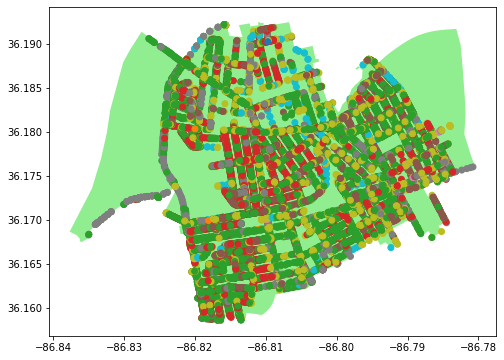

In [35]:
ax = polygon_over_10k_observations.plot(figsize = (8, 10), color = 'lightgreen')
sidewalks_over_10k_observations.plot( ax = ax, column = 'evnt_type');
plt.show();

In [36]:
polygon_over_10k_observations.geometry.centroid

<ipython-input-36-37e541eafa82>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  polygon_over_10k_observations.geometry.centroid


17    POINT (-86.80805 36.17736)
dtype: geometry

In [37]:
center = polygon_over_10k_observations.geometry.centroid[17]

<ipython-input-37-457bbfb0354d>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  center = polygon_over_10k_observations.geometry.centroid[17]


In [38]:
print(center)

POINT (-86.80805166127745 36.17736306493883)


In [39]:
area_center = [center.y,center.x]

In [40]:
print(area_center)

[36.17736306493883, -86.80805166127745]


In [41]:
map_sidewalk_observations = folium.Map(location =  area_center, zoom_start = 12)

In [42]:
map_sidewalk_observations

In [45]:
legend_html =   '''

                <div style="position: absolute; 
                            right: 0; 
                            margin-top: 10px; 
                            margin-right: 10px;
                            background-color: rgba(0, 0, 0, 0.2);
                            backdrop-filter: blur(20px);
                            width: 250px; 
                            height: 250px;
                            border-radius: 12px;
                            padding: 20px;
                            z-index:9999; 
                            color: white;
                            font-size:12px;"
                >
                  &nbsp; <h5 style="text-align:center;">Observations</h5><br>
                  &nbsp; CONC_DEFECTS  &nbsp; <i class="fa fa-flag" style="color:blue"></i><br>
                  &nbsp; SW_ATTRIBUTE  &nbsp; <i class="fa fa-flag" style="color:purple"></i><br>
                  &nbsp; DRIVEWAY  &nbsp; <i class="fa fa-flag" style="color:orange"></i><br>
                  &nbsp; POLE  &nbsp; <i class="fa fa-flag" style="color:green"></i><br>
                  &nbsp; STORMGRATES  &nbsp; <i class="fa fa-flag" style="color:lightgreen"></i><br>
                  &nbsp; SW_CS  &nbsp; <i class="fa fa-flag" style="color:darkblue"></i><br>
                  &nbsp; CASTINGS  &nbsp; <i class="fa fa-flag" style="color:lightblue"></i><br>
                  &nbsp; SIGN  &nbsp; <i class="fa fa-flag" style="color:cadetblue"></i><br>
                  &nbsp; BOXES  &nbsp; <i class="fa fa-flag" style="color:pink"></i><br>

                </div>

                '''

map_sidewalk_observations = folium.Map(location =  area_center, zoom_start = 12)

#create a marker cluster
marker_cluster = MarkerCluster().add_to(map_sidewalk_observations)

folium.GeoJson(polygon_over_10k_observations).add_to(map_sidewalk_observations)

for index, data in sidewalks_over_10k_observations.iterrows():
    loc = [data['evnt_lat'], data['evnt_lon']]
    pop = 'Street Name: '+str(data['onst'])+'<br/>'+'Observation: '+str(data['evnt_type'])+'<br/>'+'Detail: '+str(data['obj_type'])
    #color1 ='blue'
    #color2 ='gray'
    #color3 ='orange'
    #color4 ='green'
    #color5 ='lightgreen'
    #color6 ='darkblue'
    #color7 ='lightblue'
    #color8 ='cadetblue'
    #color9 ='darkpurple'
    if data['evnt_type'] == 'CONC_DEFECTS':
        icon=folium.Icon(color='blue',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'SW_ATTRIBUTE':
        icon=folium.Icon(color='purple',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'DRIVEWAY':
        icon=folium.Icon(color='orange',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'POLE':
        icon=folium.Icon(color='green',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'STORMGRATES':
        icon=folium.Icon(color='lightgreen',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'SW_CS':
        icon=folium.Icon(color='darkblue',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'CASTINGS':
        icon=folium.Icon(color='lightblue',icon='flag', prefix='fa')
    elif data['evnt_type'] == 'SIGN':
        icon=folium.Icon(color='cadetblue',icon='flag', prefix='fa')
    else:
        icon=folium.Icon(color='pink',icon='flag', prefix='fa')
        
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon,)
    
    marker.add_to(marker_cluster)
map_sidewalk_observations.get_root().html.add_child(folium.Element(legend_html))
#save map
map_sidewalk_observations.save('../map/map_sidewalk_observations.html')

#display map
map_sidewalk_observations